In [1]:
from IPython.display import SVG, display
from IPython.display import Image

import matplotlib
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import os
import glob
import re
from dna_features_viewer import GraphicFeature, GraphicRecord

from mpn_annotation_tools import plot_add_annotations
from mpn_annotation_tools import import_last_annotation_df

import sys
sys.path.append("/usr/local/lib/python3.6/site-packages/RNA")
import _RNA as RNA
import forgi.graph.bulge_graph as fgb
import forgi.visual.mplotlib as fvm
import forgi

covDf = pd.read_csv("half-lives_middle.csv", index_col=0)
#covDf4 = pd.read_csv("new_coverage_bar_error.csv", index_col=0)
covDf4 = pd.read_csv("coverage_bar_error.csv", index_col=0)    # 2 SOLO, PERO ABSOLUTO
covDf5 = pd.read_csv("rnase3_downreg.csv", index_col=0)

def plot(xmin, xmax, transcript):
    xmin = xmin-1
    xmax = xmax    
    
    # R-squared plot
    if covDf.index.name == 'position':
        plotDf = plotDf.reset_index()
    yCols = ["r_squared", "r_squared_filtered"]
    plotDf = covDf

    plotDf = plotDf[(plotDf['position'] >= xmin) & (plotDf['position'] <= xmax)]
    fig, ax = plt.subplots(figsize=(10,1))
    plotDf.plot(ax=ax, y=yCols, color = ["r", "g"])
    ax.set_xlim([xmin, xmax])
    ax.set_title(transcript, fontsize=16)

    #fig.savefig('plot2.png', dpi=100, bbox_inches='tight')   #
    #display(Image(filename="plot2.png"))                     #
    #ax.set_yscale('log')
    
    #Half-life plot
    if covDf.index.name == 'position':
        plotDf = plotDf.reset_index()
    yCols = [col for col in covDf.columns if col == "halflife" or col == "halflife_filtered"]
    plotDf = covDf

    plotDf = plotDf[(plotDf['position'] >= xmin) & (plotDf['position'] <= xmax)]
    fig, ax = plt.subplots(figsize=(10,4))
    p1=plotDf.plot(ax=ax, x='position', y=yCols, color = ["r", "g"])
    ax.set_ylabel("Half Life", fontsize=12)
    ax.set_xlabel("position", fontsize=12)
    ax.set_xlim([xmin, xmax])

    # Coverage plot
    ax2=ax.twinx()
    if covDf4.index.name == 'position':
        plotDf4 = plotDf.reset_index()
    yCols = ["mean_p"]
    #yCols = [col for col in covDf.columns if col == "mean_p" or col == "mean_p_corrected"]
    yErr = ["std_p"]
    plotDf = covDf4
    plotDf = plotDf[(plotDf['position'] >= xmin) & (plotDf['position'] <= xmax)]
    p2=plotDf.plot(ax=ax2, x='position', y=yCols, yerr=plotDf["std_p"])    
    #plotDf.plot(ax=ax2, x='position', y=yCols)    

    ax2.set_xlim([xmin, xmax])
    #ax2.set_yscale('log')
    ax2.set_ylabel("Coverage at t=0", fontsize=12)
    
    # Structure plot
    ax3=ax.twinx()
    if covDf5.index.name == 'position':
        plotDf5 = plotDf.reset_index()
    yCols = ["foldchange"]
    plotDf = covDf5
    plotDf = plotDf[(plotDf['position'] >= xmin) & (plotDf['position'] <= xmax)]
    p3=plotDf.plot(ax=ax3, x='position', y=yCols, color = "k")    
    
    ax3.set_xlim([xmin, xmax])
    #ax3.spines['right'].set_position(('outward', 60))      
    ax3.set_ylabel("log2 foldchange", fontsize=12)
    
    lns = [p1, p2, p3]
    ax.legend(handles=lns, loc='best')
    ax3.spines['right'].set_position(('outward', 60))      

    
    #graphicFeatureList = [GraphicFeature(start=xmin+1, end=xmin+20, strand=+1, color="#ffd700", label="Small feature")]
    ax2, graphic_record, features_levels, labels_data = \
        plot_add_annotations(ax, fig, xlim=(xmin, xmax), colorByEssentiality=True,
                             #graphicFeatureList=graphicFeatureList,
                             show_CDS=True, show_ncRNA=True, show_sRNA=True, show_transcript=True,
                             show_tRNA=True, show_rRNA=True,
                             showFeatTypeList=None);

    graphic_record.plot_sequence(ax=ax2,y_offset=2)
    
    #fig.savefig('plot1.png', dpi=100, bbox_inches='tight')   #
    #display(Image(filename="plot1.png"))                     #

    
genome_file = open("M.pneumoniae_M129_genome.fasta", "r")
genome_sequence = ""
for line2 in genome_file:
    line2 = line2.strip()
    if line2.startswith(">"):
        continue
    genome_sequence += line2    
    
def plot_structure(genome_sequence, initial_coord, final_coord, operon):
    sequence = genome_sequence[initial_coord-1:final_coord]
    (ss, mfe) = RNA.fold(sequence)
    RNA.svg_rna_plot(sequence,ss,"temp_image.svg")
    display(SVG("temp_image.svg"))
    #file = open("1CDS_1TSS/UP-SENSE/" + operon, "w")
    #file.write(">" + operon + "\n")
    #file.write(sequence + "\n")
    #file.write(ss)

# ALL

/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2f788314-6f36-4b4b-8f57-5ca92196f1d4', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='d90bc2b8-73dd-4b1c-96b0-f32a73e74936', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/oscar/.local/lib/python3.6/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


ValueError: max() arg is an empty sequence

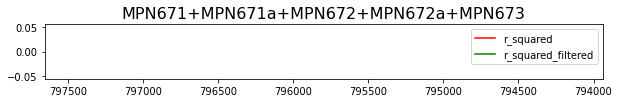

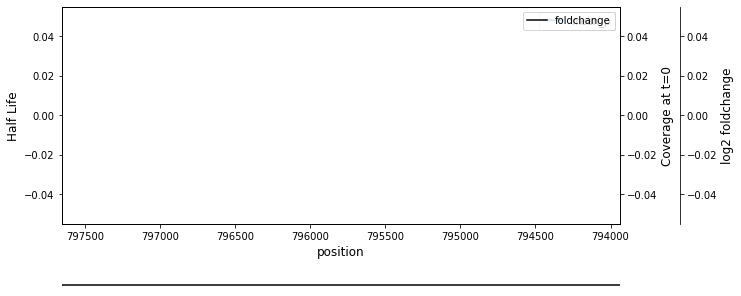

In [5]:
df = pd.read_csv("transcript_annotation.csv")

for index, row in df.iterrows():
    TSS_operon = row["TSS operon"]
    TTS_operon = row["TTS operon"]
    operon = row["ORF"]
    quality = row["Quality"]
    if operon == "MPN672":
            plot(int(TSS_operon), int(TTS_operon), row["OPERON"])
            #plot_structure(genome_sequence, int(TSS_operon), int(TTS_operon), operon)   #

/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='8ed03131-cce5-48ff-818b-95c7423cc3e7', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='d7e137de-52e2-4549-8749-3db5c006a27f', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='4a139e12-a2f3-4365-b61c-ad7d7afcfde8', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='d8a2febe-71b3-4cae-8bde-822cdacc9c8b', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='68da94e0-15a3-4a11-bc1f-1a6a2c6517b8', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='6e4a4468-f42b-4fa2-b177-56d0cb1daecc', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='8754db95-a89f-418c-bf44-19d6ad5b36fb', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='39b4ddfc-9053-4704-a2dd-98329492722c', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='3bb73452-073f-4dd5-bb21-82078caf787b', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e6f49a4f-0436-4268-8a26-a0d8968a556e', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='a4f0fe25-cdf3-4ed6-9d0e-5bc2ceb56534', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='6b4393b8-e627-483e-8ef8-a38b4e5fee30', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e11183f0-75e8-45aa-83e6-6025eb4c44c9', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2cfee9a5-8b17-4c55-9c30-73e8cff4d3dc', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='ca96ae39-e6f5-40c7-b272-0511ea1e4452', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='18a3e87e-5a07-4cc7-9352-5d10a7602129', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='eecf27cd-60fc-4a8b-87fc-6e4868a0e95a', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='9712e71c-2fce-4bb3-a891-861fa86c96a9', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='a7c767ae-560a-4b03-857a-4428e8ae9ce4', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='312d044e-40b6-4aef-9743-42d80bd885a9', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:39: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='65a0e652-5562-4b8d-aad3-832f378bfd36', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-ar

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='a2c1ebd7-8541-424c-b992-dca55b29cb2d', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b4ead845-3082-4bed-b012-ad5fc090d4f8', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='847ea4a0-5815-4026-a258-aebf0c63ec6e', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='dce004bc-1bce-48f8-a2c6-78b934c648b2', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='18bee2a6-78d9-40ad-afa4-e42229803ba4', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2d26dccd-941a-4668-9a5d-85daf7df3ad4', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='163eaefa-b8fc-4eee-94ce-ac2205fb382e', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='619e9d90-593b-4b09-9c05-0fbfdbb48ac6', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='384375ff-c5f0-49ff-8b7a-1937b9596e47', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='beae6e7e-439e-4d99-aa02-1e865d3e3aab', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='22a5be64-fae7-444e-bcaf-330ba64d4c6d', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7a58cd85-b755-4778-bf9f-c518bf7b7a90', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='1b654fcf-660d-439d-9155-a8c09d99b331', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='a513b85f-5d7f-41bc-9248-8ec29f098ca1', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='0da386d9-7324-4c66-9c3f-2ffb29d2c648', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='c4713ccf-f26f-4a30-85f9-18bc7315f7e7', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='21f96e7c-d947-4129-b641-178d91d1cbea', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='0d5cee54-940d-4c44-ba41-0d6ddc8c20eb', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2ed9112d-7f20-4d93-a6f2-f31e008af30a', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='bdffc5eb-6446-408b-bd1a-d6673781c55a', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='08f7b80d-909e-4044-a98c-f27185696072', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='0f838a40-2951-42c3-b274-40da33f9cac6', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='376a3694-2897-46c2-b1c9-a745208b9c56', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='95c9cfd0-b8ac-4f75-a8f0-edc69c0619ce', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='c5ebaf94-3f11-4f4a-95e3-e1e9960ee3da', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='963f7c0c-186c-4644-9e17-8b54633c1168', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e525f053-8b70-4298-84b1-7e1df9369027', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='9ee199f0-ee25-4ecb-b934-55f166df6e49', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='c4c8ac93-1a5a-474a-8eb4-e71fa8dc9fe7', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='5c98c95e-28c2-4a2d-94c7-9dacc909efc0', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='9e8034cd-1aeb-44f2-a694-a9ba7af74be8', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='86ab1d4e-9b81-4f34-bd8d-4526910eaff4', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='4a398354-980c-4165-b8ab-33ea3a0189fe', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='3e8fe8eb-f1e3-42be-afd4-164e7308a807', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b19a1112-d836-4289-b821-b4e93dfb12ba', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='ac2649db-87cd-4542-8a28-39223fd6b0f8', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='c4119af9-4977-4f1a-bf59-fe7338856dad', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b76dab9b-6ffe-42e5-920c-1694da7176c1', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='3f361346-631d-41df-b901-75327fc502be', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='351952ff-4251-47ad-8f4e-82e8003ca9a4', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='0e42b374-e9ed-4ac4-9f4f-aee2974d92cd', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e6bd4e85-84a7-4373-a4e4-16bbcc390a8a', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='cfcf4368-e5cb-43f1-b51d-4d808666f2a2', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='a41e53c0-dbc0-4c0e-b3c2-2b4a9d16746c', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='13135174-e01b-4f2a-ba7d-287649c344c6', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='5af93e0f-3398-4658-b9d2-340f167904b5', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='d8d8e9f8-1575-48a5-be9f-bb7fbe61e1b9', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='11dff289-57ca-4be1-9bb5-b182ba58833a', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b7333b93-8e36-4adc-be3a-16c7febdd7ab', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='c6dfa4d1-b4b6-432f-8883-75db869f6b92', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='85058492-f425-40a0-b5f8-b67400af497e', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f89db0d4-9a99-4a83-ad8f-943689879b35', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='39fc5f42-f7f0-462d-b458-b304e76cefc4', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e4c2238c-5e53-48bd-814a-9ae2ed5e4806', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='0937195c-f927-4238-bb4a-bbc5ae62566a', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='bf23ae84-5940-4709-b788-5e5760eb7306', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='28f8e25d-a86b-46b8-b612-97709af49e4d', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='317c30c3-3b9c-4d77-83ad-8854c5279812', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='5f2b3f17-9267-42e6-9d7c-c6c979fc6177', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='75120f08-8d36-4454-b36b-352851533cb1', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e186b776-fee7-4105-bb59-4dcc7feddf84', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='246af912-12d7-4827-8f4b-805b02663fc2', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='c6ad090f-ea3e-490d-bfc9-facc9bb0108c', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='9ed47b74-80ba-41d3-874e-077c10dcae73', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='061892ec-f58a-4e6c-8e31-7eaeabe72688', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='3cc72879-498d-4dc2-a2ca-3c68b050c1eb', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e2e3761c-5204-4cc5-9ded-012fcec7e62d', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='425c1d72-729a-4d30-89cb-0310fc1a972d', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='ee3d07e0-097a-4d91-808f-98cd96ea3655', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='d0b7b4d1-def4-4a93-a864-a20d0e349728', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f26a570f-2de2-4708-9fdc-fc907ef11a31', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='308dbf00-a7e6-4df8-8747-030b8c5aceba', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e837db12-bf2c-43b5-a223-f8fe85d934da', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='4ca7f59d-43d4-4f88-a8f6-525516ba373b', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='5b095ad2-f7c0-4303-a5a8-a046a2d997c4', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='4d571dbb-432b-419a-9e78-cdb02475b1a5', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='18dd72d4-9797-4ceb-905f-10c7500d27d0', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='cfd9b98b-d97d-49a2-a962-3ab6638b067a', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='93ec123e-9bf7-4ee9-9014-06ab16d27ab4', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='173a5bfe-ce07-44c0-b138-1de920162c03', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='d10403e2-02d3-4609-b2d3-d18cc16d5940', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='62aab0b5-661d-435c-be98-255bcb6f8997', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='39194484-4c2c-4aa2-ad9b-e26edaf6ed5b', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='1958ecc4-3a26-4aee-949d-07f856625df1', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='1674c085-3a77-4427-9c5b-89cb68d78521', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='c8721b7b-b20a-4fa9-967b-b719892c4803', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='95af3891-6a6e-4002-9334-56bbe51653b3', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='18037016-0dff-43ad-a051-2340d1cfbdc5', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='eca1d38b-b299-447f-8cac-9bb807e32623', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='4254f14f-bf89-4acc-b58f-2202f04e41d4', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='fe4935d4-f691-475f-8661-bd69931cd727', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='eae034d6-519c-48ec-9874-62bcfbc50ab4', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='d0dd910c-c4e5-4bab-95b7-4a6838a647c0', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='54826201-6f32-4367-bd04-c28294cb83e8', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='02d6226d-1a66-4509-add6-da6bf3764db3', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='94625ac9-2451-4fe4-ae34-52ff9cda9ea7', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7a14bd8e-bd32-437d-9688-e8d76c7329b5', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='713576bd-3048-4c71-a35c-df6a10acadae', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b7c0659b-69f3-4edc-8a9c-52c02539de41', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b8ccf0dc-b9bd-435c-a808-a9c935d7e934', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='0c0a9393-4661-448f-ae53-abdcacc7efb8', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b1d0b5fa-55db-43f4-b6e8-7c35311ce92f', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='15af034b-a2b6-4b82-b6b3-aa0ff22f9a69', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='46e06380-d4df-4cf9-af20-0593b92938c1', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e7cb54bb-b938-4a9f-bff6-7367dd247d12', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='29582767-fd26-4a32-85d9-5d9916082e98', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


ValueError: max() arg is an empty sequence

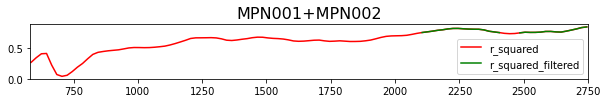

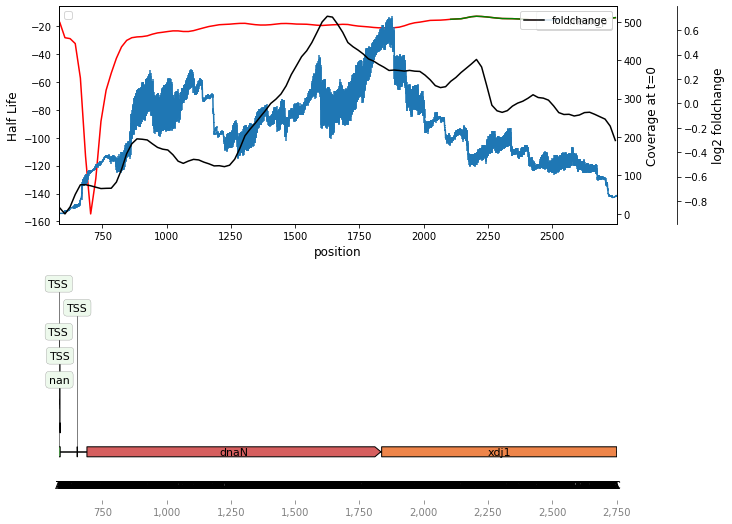

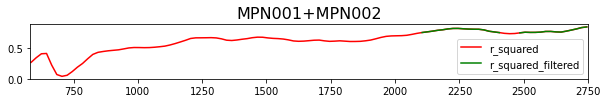

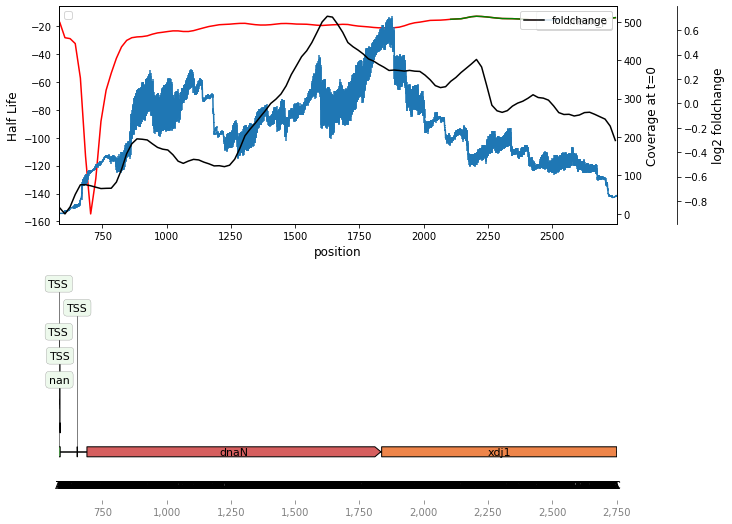

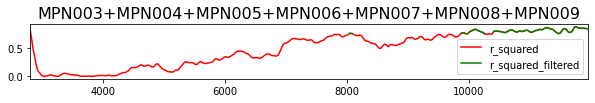

...

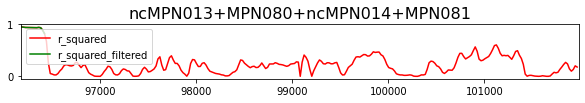

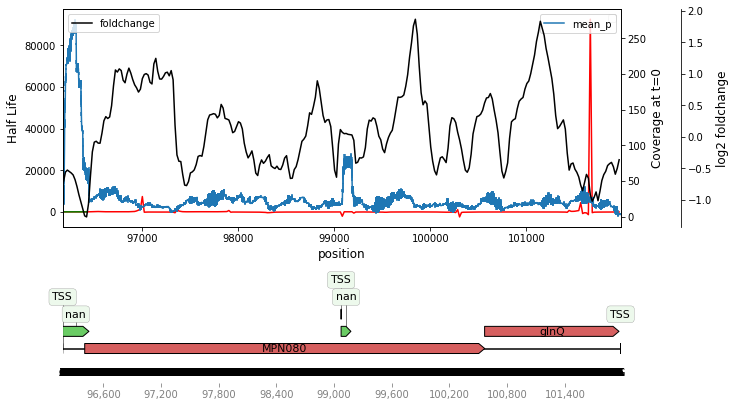

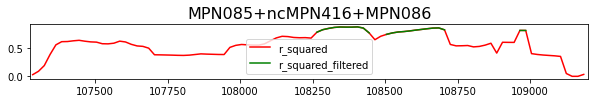

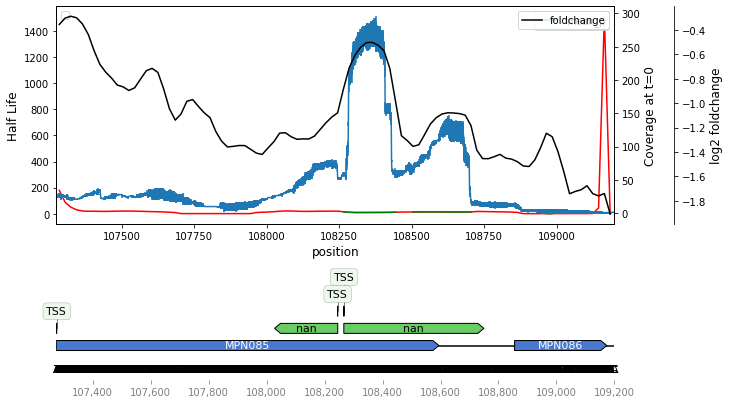

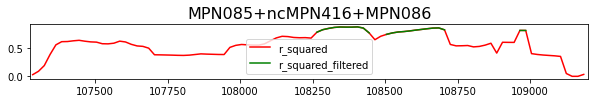

Error in callback <function flush_figures at 0x7f2562ebf2f0> (for post_execute):


KeyboardInterrupt: 

In [3]:
df = pd.read_csv("transcript_annotation.csv")

for index, row in df.iterrows():
    TSS_operon = row["TSS operon"]
    TTS_operon = row["TTS operon"]
    operon = row["ORF"]
    quality = row["Quality"]
    if row["Strand"] == "+":
        if row["Quality"] != "Y":
            plot(int(TSS_operon), int(TTS_operon), row["OPERON"])
            #plot_structure(genome_sequence, int(TSS_operon), int(TTS_operon), operon)   #

/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='d8334959-d857-40fd-be06-58fbda9cc533', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='fb41aeec-9ae2-4daa-94d8-050395d5c97b', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='94cf4119-9b64-4ef7-845e-252eaa759cfb', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='21c4073c-abb4-41f9-abb6-a80ecd377f30', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b8ab26c9-7f0a-46a2-ad6c-4400227d0d37', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='534a2402-54b2-43ea-a05f-382bedf26f1b', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='0adab8de-2979-426c-bdb9-ef42bc9e9e13', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='5e455234-5896-4ab6-88a7-280be7925041', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='14c8e359-aec4-4ae8-80de-14b98cb6de2c', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='faefda38-2ea6-4e01-8363-d4c01be6c186', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e1a07f5d-ae4a-44da-9557-a00b004c08c9', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='8cc5d69d-aaf8-43d2-9884-72ddbcadbde1', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='349b7ab7-50c6-4708-a667-22dc29b7f273', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='d83f33ee-1908-4a44-80be-5e1ba306fc28', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b9231af6-c4f6-499a-90e9-569fe4359309', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='4a4f6eb2-b451-4488-9aac-4741b2d67f17', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='1b17abed-75ca-46c8-9221-14a8a966dfe9', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='cf721ed8-d9b0-4502-b660-c4e998dc71ae', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='3d00d21c-7577-4700-b152-6704ab13f61d', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e5a3f777-e98c-44f5-8844-51ee89d8a20e', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:39: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='019bc36a-a913-41cd-a947-90f24fd34ac6', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-ar

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='d37d6829-9937-4f08-922f-9ca3c6d6ce39', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b5302ed3-91b9-4c79-89fb-e4f7510d19db', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2ffb278f-93cb-4969-924f-f3f882aaf12c', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='311f7f8e-03de-4f4d-989b-3739648b1f37', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='4b9d8c84-f071-42c8-8e6e-4e0469cceb9a', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='595ad7fb-fb6c-42f2-8d97-58f4f174a8e8', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e3dbd834-4f6c-4620-b5ab-ce8f53c44a7f', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='64400d80-dcb2-46ef-b22b-f9f9553939f5', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='405d376c-fb2d-4444-8a64-f32c862dabe3', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b343fe69-b21b-4fbf-984f-062631c4c9e8', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='04a39a58-95c3-4ba8-bfda-f56feb208bc7', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='732909b0-a7d2-4af9-a678-bfd8c5d23e1d', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2eea2a96-62e5-406d-9c3d-bc9658462c7d', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='95ee490e-d96c-4d65-8774-969fa4d2ce96', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='982024ec-83f0-429b-a7ad-c5932cc098da', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='4347efc6-bb75-4c31-9d77-13408e61e833', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='470fe2f7-abf8-4455-8303-e83d8c244ea4', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='bdb90a5b-3b4e-4920-b497-064a228d64e2', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='3b0a1f78-a7a3-4d0f-a2b4-fd9585489f46', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='ea61b488-bea1-4f5f-be62-7ceefc48ac67', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7cb31925-9469-4c7a-b92c-4f78f89f8c2d', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f667a785-b243-432c-b989-5fbc12085497', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='acaf145e-5fac-4d4f-b92b-ead205cdb9da', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='71ea8640-b3d5-4811-be37-6deefef23f74', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='8ad48068-e7eb-4f52-b782-37d1384430c6', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='a26438c6-222c-46bd-b633-cf6564ccc301', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='fbadc9cb-5337-4184-b0ca-e9004ec49e93', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='6b574738-d775-4832-976f-8089d5a51c44', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f970775f-6dbc-46ce-8901-813ab53eff8a', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b0cab551-5647-4454-bd88-c02f0933cf6a', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e25e17f0-5426-408f-ac85-76879e0c2b6d', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='547c6653-1d13-4a0e-85b3-2c6d6b168f4c', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='0078652b-c69b-47cf-9421-1ce6d95782d8', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='ad46e61c-6410-4dc5-9712-34b639d65684', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='d4f43417-6da1-4f2d-9fa5-ec7daac3ead7', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='3571af6a-0dd3-474d-bca8-393060376cc3', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='34ec4038-e9b3-4db1-bf76-48be7fc0f2a8', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='bd148e60-fe16-435f-977a-cdfb9698dbd5', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='48e40fdb-3c40-48bb-95c9-2f397fb7620c', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='784fd225-77df-44a0-8f4a-971e46d2614c', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='81006e63-6394-487f-9572-a75a50b8fd76', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='c6775bbf-dcfe-416d-b3ae-86e1c2ec931e', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='eba09174-ab70-47e4-8890-df2c43e7b114', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='4e873b3e-18b0-430d-b12d-803dbe549892', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='837b098b-6e9f-47dd-bf29-d9be361710d6', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='8bf1560d-3704-40f0-8019-fb058ce732bc', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='dcb7c27a-b906-4f8b-abfa-f6342000d484', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='9c97d7f9-9434-468d-9f99-19e062580e61', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='49ca5548-d478-46e1-afc3-96801356aafb', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='6f4880ba-72ab-4884-bc5d-c0949eacf68e', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='3e1ca0d3-106b-40ed-b484-4d0d5c0f85e7', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='56d95a9e-1d14-415f-bca1-ce5927f356bd', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='d16c521e-83ce-4add-b8c2-7730b136276f', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2f8bdc58-e702-4826-89d5-214f48ced605', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='fbf12f5f-2c29-4d15-8f56-c5618b3c1265', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f4e620b5-0007-4bd8-864b-ff62c050ac5b', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='1da8ae9f-71c8-48b9-8e32-563660cf62cc', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='4f0a8968-2ceb-43b6-a13a-9ce475a4631b', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='db2c5b45-4228-4bf1-8bd0-e36938157d62', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='c0850feb-fdd3-4329-8799-3a6db3323751', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='59a1900b-66b7-41c8-b411-fc346569226f', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='28b78e5b-cbc2-4557-8686-45e81a9e0853', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='d166830d-e90c-42a1-9cb2-0b9adf3faa04', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='06820c22-3518-4417-9fac-bdf8f948ed0d', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f53373cb-505a-43e5-adaa-1b6d11b36039', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='3e2e84bf-1fa4-4433-91fc-9fa36bdae8f4', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='8ebdd13a-fa60-4c3d-b07a-f32ae86eba35', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f38bee50-398e-4808-a48f-223707c09073', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='ce5837b5-ad3f-4c49-9163-7e6de908d228', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='0b9db12a-ca26-48ec-a320-1d82539f4675', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='ea8d1f7f-44bd-42e2-9ad3-1b08614cb1fe', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f3836bc0-bbec-4081-a9e5-f19f22bfaba2', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='a51e0c04-7a2c-4472-a4b8-d393a90a43ea', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='8ee346be-8a82-4136-a032-3dc7e46d4ea1', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='12b169c6-adeb-498a-a158-80e294302094', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='32c6fa68-4927-4b27-a30f-1c269503da84', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='5d9d327b-e765-47af-ad4b-41a7ba66b1f0', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='8272ad0f-2b09-4150-90b7-bd1065efaa1d', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='c02a6848-0b59-4fec-9a02-85c80594dc02', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='46a26590-8529-4de9-9eb7-7be62eca0a0c', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='3e87be34-cb65-42f7-9c17-78b27110131c', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='ce85be13-2f67-411a-8725-d0c2a9f89cb1', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='0f790564-fa95-4ae8-9038-93f3653ce6fc', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='192c62bf-9175-4b03-a910-f097d605f977', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f179700d-5e25-4c42-a4e8-7a94a4977947', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='bf9a7b92-84be-4cc2-a803-d311b22807b6', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='66ada198-a1c9-4635-bc7e-65f61831096b', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='01b1049e-f9e6-4874-8904-6b59a7c5bfe3', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='62bc09b2-8d90-4597-888c-6eff5526d223', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='9136be34-40df-4756-b3e2-d0d0729a3c89', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='ca30559e-0ca9-4deb-a139-841f75eff333', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='5bc865ea-e01b-412e-8316-9116237bae28', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='13b1582c-11b4-45c4-a164-8bb2fcd8b349', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='6aff9ba8-f7bd-47c7-a402-2e4829a12a34', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='bd6ef9bf-37bf-4388-aa59-051e260b2c7d', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f3231edb-f56f-425b-8931-8c079a21dd72', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='3a3edd82-1c87-4da3-87a6-23239b34d078', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='97db9bc9-eb96-4a6d-855f-182c85eed0b6', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='5b3fd8a9-d520-47f7-b4cd-9b1f4d5dda20', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='8babf18a-4f4c-4076-b0e3-fc59c865d6d9', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='a64b0c8e-e585-4249-a99c-6fb238a7eccb', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='cf2fa775-3651-4e81-a23a-a167cdbd3949', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='18e5db2d-3000-4105-845d-9877222c9a44', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='1f0590c1-0ac2-48f4-8dad-eba176bb9790', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='9ec09ac0-eb96-4b36-a08b-ac8049b0699b', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e475254d-0625-476b-8a4f-7d3242b8de9f', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f1b346a4-adf1-4f6b-9474-a249dbb5ad09', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b704f3eb-0a95-4c40-8c07-cc7d1fbdf0d8', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='1e342f84-f17f-474b-ae5f-1a56e593a7d6', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='55d510d6-33a8-4140-9b63-f33ceb6a97d4', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='de8dccc1-86d9-4cfb-a90a-42d5e758d849', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='3cae2360-a886-457c-a10d-ae3273dfab6f', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f660d7ea-9de3-4eba-98ac-76c2813663cf', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='96ded4cd-6ab8-4ee3-933f-3d09d6dd74f7', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='a50a7101-c903-40b5-88e0-47b2fa0de842', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='9127a08d-2fbb-4f95-9ade-bdcce6152ea8', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='032a1911-6e44-492b-85a3-9b41006e45c2', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2d54b092-ebdd-48a0-89b2-ed450af1256e', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='acfa8bdf-f2c9-4fc7-9974-09f5dc30fa3e', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2f842070-d388-4d74-a624-02de485a86f8', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='93e8cf70-6546-4a79-9303-86228cc69ee4', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b6411f5c-1f01-4fe1-b714-9702d9e409ba', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='40c0474f-b886-47c9-9761-f252e64ef499', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='6610b86f-fe8c-415e-92fc-ebb317784791', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='0ad9a1e8-de15-4e49-aa2e-ef8aa70c5534', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='a45d386b-4ba4-45a6-877a-0fe10c5386d0', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='604868ef-99a7-4836-a4df-2b818b5fa9cd', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7b857112-9086-4092-8f73-170fd0283e91', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='11bdcd39-df72-46ab-8d03-2b9c89c0edec', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='c4fda5a8-414f-4215-96c8-25abc68df774', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='8b55bd57-5416-4bca-8398-ca325b32f25a', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b5d343a6-b378-4de9-8372-332c8acd4322', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7167f277-c131-4e62-bc8e-d7d15949d8a9', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2d3ad68f-c090-411b-be82-21b0bae8cffa', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b17a6d6f-e9c6-4525-80da-355145e2efca', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='dc6404a4-40c1-46b7-af34-7f733f768a4b', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='65778e7a-f7d5-484a-ad70-42b225783494', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e76d91ed-7db3-4e7b-b29c-a321de2c668d', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='ebb04f9a-3b67-43b5-ba9e-30d3f32c7a80', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='a1d52be5-d42e-421c-b2f0-dee18ceba89c', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e0502723-6d17-4231-ae6c-0f224bce020c', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='36040929-e403-4e89-bab6-0bbba40160fc', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2069b26f-0e14-4332-a2bc-1ab1a39eb06e', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='a7f69f7d-7cf0-4947-a796-3501493bd3b2', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='39464191-a4e4-41d9-85ac-3fc186621b0a', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='eb2daa30-67e0-4858-8972-1ffc4478b028', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='6bffb707-c87d-408b-bd15-f9ac72733be4', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='c67a4fcc-e3df-4f92-8eb5-65474f9d83e7', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b342b452-ae62-4cf2-b1fe-8a35a64ebd0d', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='bdec4e6f-404a-482a-83eb-f62e9f561e37', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7bee1af9-ee79-4183-84e0-acac59e75fee', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f5313dd7-d9a4-4caf-ac98-aace9473efff', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='4628cba5-23a6-4fa0-956e-4afc5969307b', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7e70a08b-ea03-4107-8e3e-04f7e6e9cb69', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='1fe51d58-05db-4998-9c51-48aa824a28bb', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='6cf1cf5d-88de-4647-992c-2ebf36f7f789', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='48421e3b-dc7a-4810-8496-188e6ae1f7e8', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7fa9b01b-bb8e-4e3f-8ad1-1fad11a5961b', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='57ff094a-8761-40ad-b1e6-e6312935acb6', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2db70e87-7add-44e5-ac11-8ffdabc9e42d', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='47200cd3-7638-4e0d-8696-0207f03c8187', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='792ec5b2-ccf8-4a20-9c5a-85b597101a3f', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='8caf1023-1543-4804-83fb-4db4007fffae', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='9326ece3-1c4f-4a84-b421-4e13fed54bb6', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b89181ef-84ea-4383-bc3d-82196308cad4', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='15330a47-4ce1-4d7b-b217-e2e9de354fa5', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='17508da2-ea9e-4480-b16b-7b3a271f9398', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f4167f1e-08f4-4143-97f6-220c4deacdd2', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='fe5434de-3549-4167-ba41-55ee2ae04a4e', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='60f42b8c-fe1e-492d-881f-61233be1dbba', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='246570aa-f5e5-4cad-909e-4ad1530550bf', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e0f24096-52e1-44c4-bd72-96affb431bb9', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='861ab888-e2c8-4d1e-ba3b-a317fc5443eb', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='3f4ec315-181e-4d71-8946-a0b848dc5e82', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='d278c4f6-c145-4293-b6f8-652439e71df8', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f0834bb9-4ea7-4650-9b42-16ba1fc96551', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='33302c47-6253-4cd0-a636-9e348559054c', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b7fd4b04-dda3-481f-b9bc-3e3d46cf9897', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f0ee7563-d7ba-49ea-88e0-f45e63e5235a', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='badc8158-39a1-4275-90b8-10e463047e01', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='ade8bf1e-6864-417d-a62d-3f110e3a84c0', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='03877e25-d34c-4856-bbaa-890a0c72d7cb', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b355caf8-3d29-4f71-88be-8442faf4be8c', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='9d3e5834-1349-4961-85e2-523598805858', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='67d4fee0-9dcc-471c-b09d-6bf5e98d10e9', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='92b656ee-1edd-47d5-8f66-99ed7b66995c', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='6db91889-8dd6-46c2-9158-17a4ff58c30d', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='a16a48e0-887f-400e-a6ec-ac9e845f5590', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2a85af80-a553-4bda-a45f-46df985ef28a', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='64711f16-641d-4763-842a-08207eda5fcf', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7b3e1058-2078-46f8-863f-4db0a16c87e9', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e4841754-4878-4e8f-a8a3-45d58c2d7998', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='081d6a81-0fb0-4642-99c9-f6bfff44212f', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b8b6579c-1bdb-41c1-8483-790b31771128', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2f9cc1bf-80f0-4a99-8486-7b338d135987', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='4b44a1a2-121d-46dd-a8b0-9c058580ba69', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2b017a69-687c-49fd-8ee0-979de3d4e9d3', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='5fef737e-01b0-4793-b705-860f33b4fe88', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='3de22b33-74d8-4e31-8359-a6d3d2e9c5c1', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='57b222f3-ab10-45d7-bcb8-30c7f4535973', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='bad2218d-87ee-4af8-8c27-c208ee4b037c', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='4ade6f27-64cd-495f-95a9-edf1914fc46b', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='06416f8a-03c8-4df6-8d2b-5b596ecffe68', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='cd1cfa80-4675-4673-9d72-c577b4ddbef3', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='94627421-65c5-4d7a-bf32-ef6a13f76aa8', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2b668fed-036b-46c2-a81a-dfb71b13b0c5', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='9ead1e27-602e-493f-933c-9dacf3a92805', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7c6313ea-2235-40ea-b95d-2bb1fa3516bd', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='581a4afc-d504-4f44-836f-52815398686e', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='d7a03e19-f2ee-45ec-9a47-23d976694320', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='91431b1a-b7c8-4955-8831-95ba1450ef8c', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='0c3fd8a0-3a0b-4ca5-b999-3d3e88d66f35', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7f985f34-3b33-4ef0-a7d2-3f629374e1d0', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='66fa61cf-911b-4782-bab9-e6a7d346054d', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='44742292-2981-455d-877d-11337a129b56', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='8f132ccd-9614-4415-8186-749b659b359c', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='cef19a43-6354-462e-ba75-f85eade38c07', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='801b5f63-129e-4a97-b094-a95f25302317', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='25db532c-18be-4f6a-9bcf-037f1b10abd5', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='dcd90010-7fcb-40fd-83f3-f3ab9814020e', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f032f471-7a01-48fb-b59a-685cdb6f2366', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='0088b9b3-d0a6-44e7-b354-c13de2dbfc87', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='eb2cabfd-bf88-4d69-9447-5655102c5050', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='a2eddb0b-b412-4df3-8589-20ea9ccadecf', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='6fc9471c-e114-465a-8cb0-cc0ef32c8b27', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='c5c139b0-ee99-4fc1-b106-9408c9f7246f', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='d91e2002-8b47-4a41-9d66-1dc90c54b843', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e3556785-edf7-4458-ad8b-cf65578ebd0a', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='121860c1-4a83-42da-869e-c7527bf4775f', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='17624af6-1bf9-48ea-bf7d-34d9c230ad02', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e36f6ad0-cf80-4fdb-8055-47e857d9c067', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2a9e646f-450b-42bb-9a00-b2a40e991064', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='d7738061-26d0-4ff0-9f8e-6460799de5b2', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='656543d1-3d11-46eb-909c-a0e812dda3dc', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='9f788bf3-5f2a-42d7-b248-1fc30211ed88', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='29b289f8-b3d5-4d09-805a-aba05657adbb', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='15473622-75cf-4c84-85d0-d13da99720ec', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b024dcbd-335c-40e7-b601-827e37975628', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='44aaafff-ba9e-4748-ab7c-af09b0e0d77d', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='11eec075-68e0-4eb9-b709-4917092932d7', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7c8bd87a-5935-4ca7-ba23-b8a26b95e7ea', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f8a6891d-6cda-483e-9a99-c47a2382c121', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


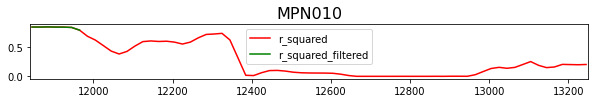

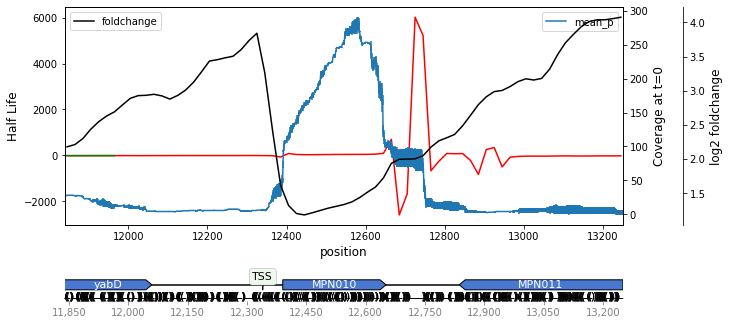

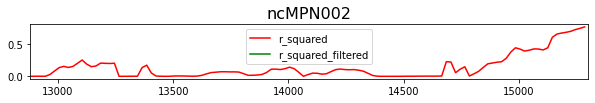

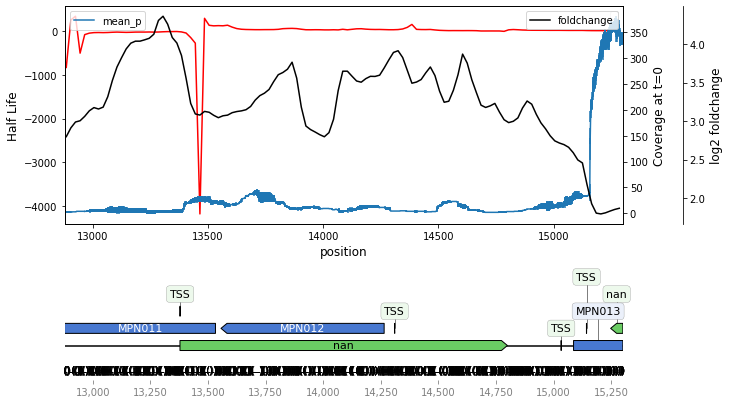

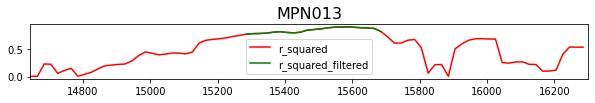

...

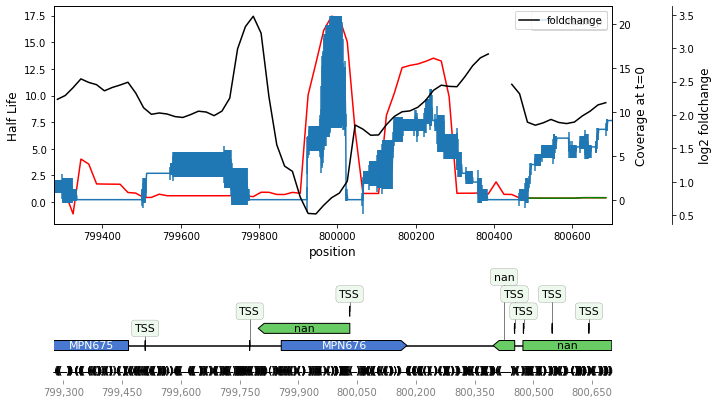

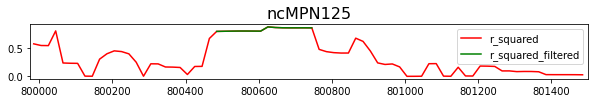

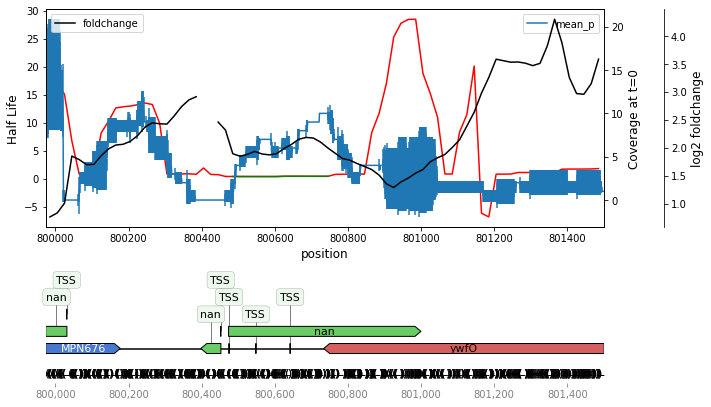

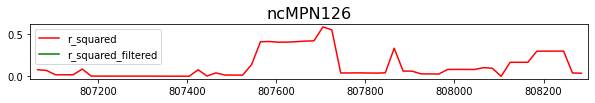

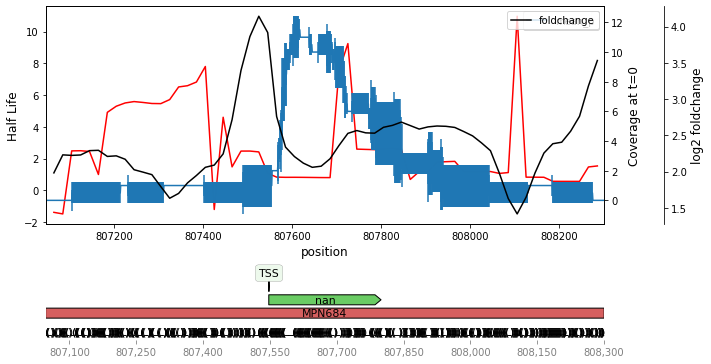

In [2]:
file = open("1CDS_1TSS_operon_coords.bed", "r")
for line in file:
    line=line.strip()
    elements = line.split(",")
    operon = elements[0]
    TSS_operon = elements[1]
    TTS_operon = elements[2]
    if TTS_operon != "--":
        if TSS_operon != "--":
            if elements[3]:
                #if elements[4] == "UP-SENSE":
                plot(int(TSS_operon)-500, int(TTS_operon)+500, operon)
                    #plot_structure(genome_sequence, int(TSS_operon), int(TTS_operon), operon)   #


# STRAND+. 1 TSS AND 1CDS

In [ ]:
file = open("multiple_CDS_1TSS_operon_coords.bed", "r")
for line in file:
    line=line.strip()
    elements = line.split(",")
    operon = elements[0]
    TSS_operon = elements[1]
    TTS_operon = elements[2]
    if TTS_operon != "--":
        if TSS_operon != "--":
            if elements[3]:
                #if elements[4] == "UP-SENSE":
                plot(int(TSS_operon)-500, int(TTS_operon)+500, operon)
                    #plot_structure(genome_sequence, int(TSS_operon), int(TTS_operon), operon)   #


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='9fd038bd-3608-421b-9769-511930909b1a', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='848bd811-9560-49d7-903c-c077ceb2c1e4', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='09c9d008-8df4-4238-8d6e-b6f5dc396008', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='99a81d7d-2deb-4949-b990-ca8982ea915b', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f4c5262c-4f23-4370-b5d2-2d19e2efb0e8', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f24a7cf5-9ceb-4ffb-b49c-48fca1d4fa9a', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='5ff908d5-fdbd-4c4c-b65e-b50b13b8713f', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='5dfaa3ba-8689-45cb-9218-8f82689d2fa3', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f06e9cef-bc53-4f5d-97de-706ebdb0e67a', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='c8beb524-e2d2-44cf-b561-e06b6c666839', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='0af6849e-c93e-44eb-8ea3-df2613011c07', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='33f4f826-6415-49a5-ad96-b3ef62af5121', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='219383d6-2b97-4eb7-9c50-f648bad9db69', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='40aed184-2763-442c-a3d4-de6fd4c55685', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='de8bdd5b-871e-4232-8952-53af2c6ee115', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='4d4963c9-4caa-47c9-83d1-4672a3344033', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='77902037-fc40-4a3f-8555-e01f94f667f0', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='bcb999ae-8a89-408c-bf92-35a4bab2e1a4', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f2d796ad-2dec-4760-b06a-2543bbc86641', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='65e84f44-defb-477a-83cd-5421987ad850', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:39: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='550ab003-895a-4af6-8a61-6cb4eca09a8a', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-ar

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='a32679be-4db5-4bf7-94dd-5fe5932152dc', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2c1fdd94-1208-4cda-88c3-b5d6caca413c', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='db81e050-f94f-4414-8cba-e404e1746d26', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f6101a78-5c22-475c-9deb-2f9ff3a0fa7d', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e9b05b9b-4470-4f7a-8a01-533875682917', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='636c5442-cf0e-44cb-afb9-7939bb749020', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b1f05437-a48e-42bf-916e-957f958b95e2', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='0df3108b-5c54-467f-a678-e58178ce58a9', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='0617075a-6e8d-4d96-addc-2a1dfe3f2612', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='456e7a42-25f9-4529-915d-21a99b9c0b3d', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='31855b63-cc89-4e62-a17f-128c31db699f', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='9bb152a9-a8aa-4090-bb36-baa04839761d', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='c52bd47c-4a40-49d7-9276-0345379ee6c9', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2d375fe6-09be-49bc-be45-644c8e35276d', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='698540e0-2358-42ab-ae9b-b735ededcdec', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='aac1af57-5108-4aa5-8765-fd9c987d6e38', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='ca0fa506-4f60-4b05-a4f4-3bcfc65e0544', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='49ae13aa-9746-4442-afdb-429a5e520ff7', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7542871f-9d63-4d73-a3e9-ef25f17f218f', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='66fd7ef0-020f-41a2-8080-6399b1407ee3', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2177402c-556e-4339-a1a7-bba47163e2f7', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='14f8d7b7-345a-43c0-98b9-5b1493df0ce9', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='12e62f48-2aa9-4dbc-9086-13a026734942', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='a0a771bc-041e-4639-9b24-b8bbef882117', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='4f854bec-83d8-4c7b-8524-148445a6c4d6', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='6df7daa4-2b83-43ef-8497-c3064665ca60', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e89ea926-39ac-40f9-af6f-fd3d22e1774e', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='43c43222-2c5c-4dde-9daa-656b40bcfe08', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='6886cf67-3169-4cc8-a308-83980f6131bf', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='742d9a7b-c816-4d80-ba36-1c7caff2a71b', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='8ac66a1f-2b7d-43db-983b-26fe6a6bbcdd', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b86a5eb0-f0cf-4765-be9f-4fef1fa01611', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='73f6c01e-4695-434d-b99b-163918100e05', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='21aa6f6a-06b3-45ba-a4e9-3ca9bb01069c', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='edd4de45-2dca-4e59-9036-0fcf8a046573', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='d886c351-e0f3-4adb-b9bc-1637a33363cd', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='da187c61-1c79-47e4-8256-d4c47fba0e1e', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='82d88e56-d3e5-4434-a34a-3887e9747ffa', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b725b65b-10ed-499d-9ee7-e3f39ca5f44f', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='cb47687f-91a5-44d9-8363-0c7deda653e4', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='147bbca0-9dff-4700-bb4a-b79d8dac0151', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='1130ad21-10ec-4527-9306-4e918b56c03e', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='6e04d2e4-9744-4375-8d39-f9fdab8ed656', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='d0e07e66-67d1-42ed-9f5c-7c1e420b57ee', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2f4bf4d1-b891-4b8e-a5e8-b0182cfda19f', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='fa9d75c9-1b13-41be-90f9-ba62dfced1a4', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7f1c3315-dd38-4dd6-8b66-b1248c5edd50', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e758ec8a-d6a5-4cd5-9aaa-256c3b142a1b', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='315e5a29-cd6b-49c0-91b5-e7d2cd8ba01a', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='fa589197-6292-4f9e-9183-2f93ee70df82', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='87f14050-ed20-4446-bcf5-8b86a01f2259', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='199db260-8bac-423e-8d71-5299b8db0cca', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='ae4a8a13-647c-4e41-b0df-e97ab01b7c62', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='90967f0a-aac5-479d-b1a6-abc7fccd4e7b', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='9a47d558-2502-4091-bd46-61788bf62f41', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='8897ccf0-eee3-443b-94a0-b669f026d9c3', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='42819836-d8a4-4aaf-9cbb-0eda22c0ee91', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='35f102cd-7abd-46a3-8b04-c527bbfd11b5', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='cba0310f-09b7-487e-b5ba-f8a9abd947c0', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='872f6203-07c6-476b-84c8-743d68ad8909', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:39: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='59c16e28-e176-4ab1-9eaf-9c2e96362b18', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-ar

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='5d50521b-2cfa-4454-b397-41856c4af39a', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='597eb994-58c1-4de0-b19c-d9c7694bc74b', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='200974fe-e869-4380-ab73-b0d0d204cc56', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='61d33079-8934-4622-8828-02fcd04680a7', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='4f953a3f-51a1-4d9b-b55c-cbb60336808a', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='89c612ca-50ca-47ac-9cea-6119b802dd23', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='1b002ff9-b62f-45fe-b8d8-d2b5fb5a1c8a', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='df24be9c-9dfe-4ae2-9779-f1a0e6e68a11', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='37ff2116-71fd-4c53-8a78-03e8d5b3f926', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='de98e1d0-972a-43c2-a70d-3554b7857e77', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7e37d932-cb4d-48b7-be0c-dc6bcce653d0', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='9459f1e9-1367-4c6e-a60d-d3821fec4f36', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='1f83ea3f-613e-467b-a068-8142c6feb738', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='154404a6-358d-45ac-9ebc-cb055fa760ac', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='61a73bc5-44b4-4d20-84e0-67f54e5a9e57', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='4ce8ac31-e0ee-4261-9805-b12ef5c6daee', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='cb4c7f3a-f33a-405b-a79b-b8ce24ae784d', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7d4a3c60-51ea-4eec-9e78-e73802152000', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='55a9e9ff-23e0-4c63-bdb6-f6110292a489', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='80337726-71e9-4b8e-8ed7-63e4487aee0b', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='14a47984-558c-48d7-b4f1-85100a5e884d', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='d490a126-c55d-49e1-ada9-005f374e5ae9', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='4dbeae57-1f04-4619-9664-0203f859a27d', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='88ef0d8d-70ee-4755-9d17-7d84efebe85f', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='62a3e540-afc5-4696-b588-ca20b2b974da', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7fa5c07a-733f-48c6-ac29-f4e2a6fb1991', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='47502114-aed6-4179-98ac-dc228db58652', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b341ad8c-1d55-4bfe-aee9-8da815304900', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f162a701-03aa-449f-9d2a-6a879ce17ba4', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='c9f4be70-e4ee-4756-a6c8-eed9931d64dd', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='582a507e-6669-4b79-8abc-bb4f2804edf2', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='44fb2d03-4b1b-4384-876e-c4f532629da9', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='c0efba2b-66d2-4872-a2a5-c865d95a2b1b', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='58e79008-22ca-4d35-b577-844d1a8c5a57', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='baa71caa-f0be-41d1-925f-f427d324e0f6', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b7959c85-9552-4e27-b9a6-ec63979eb983', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='6f9efd09-cc4f-4dc2-8e41-c3b0a41504f0', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2c2487a9-c880-41f0-a9ff-93860b2fe99c', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='ad337757-bd4f-45e4-a6f4-4974bffec58f', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='6b4fda8a-6673-4482-8fc5-8c7a32354f91', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='676fc2cc-9c7c-4c97-8cc3-c9f6350b0525', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7af6b7b0-b535-409f-9d9a-77d276b0f739', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='96cee90f-7024-4304-924d-b053f4595150', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='aeb1dbec-70c4-4a00-a3fa-1d0caf6e9803', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='17592aa3-2aeb-43fb-b9ed-7e673a41ae97', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b4e4e42e-bbf0-4e91-b8e2-e95a949eba50', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7b20e784-716e-4dc4-8b47-510b6218343f', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='ff8cb6c9-0c6e-452a-9a85-3acc223c83fb', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7d04d344-1e3b-4ce4-ac73-2969b76366d0', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='37a7d487-b9f0-49ff-9bed-1ece8773a1d0', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='1f3ec74b-782d-43b1-a73a-b8b9ceaee323', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='d36c3b10-6fa0-47a2-9489-32167fafd7b5', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='1c4641e7-9198-4632-adac-2fc63487d7dc', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='fee1a4bb-fff2-44a3-8e1a-2c23be58e106', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='a6070e67-7a31-46a0-83a4-422f7010817a', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f706b555-5e61-4464-9a2c-1fdbd5fabcb3', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2af37358-d74d-432a-9085-e4c9a988698f', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='98d4860d-03af-43c9-ac77-df49b80ad4e7', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='72292935-7b04-4514-9d6e-60fb095480a8', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='c553a2b6-383f-4cc8-8c85-4035724931d4', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='cb1d4bc4-5796-4d63-a994-8c6b7df3d50b', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='695408ed-710c-4be8-963a-5711ff3fb04d', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='1c15ab3f-a89b-424e-9892-b023275dacc3', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='29f776bc-187f-4dad-8d52-7ad656ff5f60', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='72db22c6-1341-48de-817b-137668398583', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='44912a34-9a96-4257-80d6-43019d1c6581', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='4c3837f7-16ea-4851-b535-7aa77e72eb7c', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='a86b2df7-19ac-4372-a268-e90b3a14dda5', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e7c383e6-1e58-446f-83c5-8ff75ca21a74', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='cfb2edd2-d6ce-4f0e-9fa7-6709b0f54781', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='8ae09ac2-3bd9-419b-add6-a42a1153c793', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='afc0d231-1b6e-4818-b1e5-9575e17f974d', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='db1922cc-00f9-4524-8bb6-b2969cd3e933', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f7972dc9-89f4-417a-94c4-747f49b05ec8', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='fa0ad8f7-ba0a-4208-8738-8f254b709db6', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='84f878c7-99a1-4996-b2a2-61a03f52e7a7', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2beb6f14-82b7-4da0-84aa-ad87fab4cc19', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='342e849f-7b8e-48d0-ae65-33afdbc5e124', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='31f91993-e4a8-4f4e-9c44-1b77fe8fc606', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='57ccc9e8-ee01-4f31-8ad3-78a43c78cfd5', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b96965b0-2f11-4df5-ab99-92da9cc66ff5', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='142deed1-4965-4280-8c32-06b8fe9c1ba7', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='0038a4df-f8e9-4a0e-a4bd-b8540f451ef7', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='50411a67-9b40-4112-b00e-30b1447b7504', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b776a330-b0a5-4b81-9776-475ad727694c', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='567c151d-ac0c-4cae-963e-6a8dc7df9a2f', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='60a1645a-26e9-4b0c-a215-66d8f61142da', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='4f385721-2c11-49b5-94d9-3ecfa54d4632', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='aa9c4ce6-2b0a-4ac5-88ec-ee4b3ba4d3a2', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='68437f64-63f0-4796-adcc-4e8d949255df', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='4c97f4d8-2136-4572-aaf8-2e0b1880229f', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='5a1f399d-2c12-4be7-b4da-3782c14aed52', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='d22c2e3c-7d01-476b-ac55-e8217883ab2a', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='89684b5e-1309-452b-9d9c-8c3099cdf703', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='1e5997e8-6952-49c7-8413-3380ecd466bd', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='72438e8d-4159-40b7-9857-495f424d8004', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='98360de7-23cb-43c3-9621-f5cbab97c5a1', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='74f643fc-591d-4c88-a3a0-3311102be6b4', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='c32654ba-d4a9-4dde-8dd2-c9758f0ba08a', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='286714f1-c642-486e-b854-a14785ac6246', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e7a19802-f088-44cc-8589-9883c9bcfc92', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='9a62e63f-c41f-4177-960d-9681eacdc672', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='497cce34-c800-44a1-86be-9c16dbbbf95f', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='da1924df-97a3-4671-b30b-eab3d8c0a9a2', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='62314913-d541-40d1-9334-ed0620021025', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='12745193-1f4c-4166-95a9-3e12532ccdc7', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7f93a414-e3fd-49f2-af5c-dfc6cd1cbec5', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='391bee53-f862-4ec7-85c6-256c7d07d971', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='91daa7cd-9f3b-4f8d-b7d2-b4b22202595e', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='96705d7e-a150-43a2-9e7e-58ebcc817d08', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='727bdd0c-7307-4704-8e97-1c1e448a05c5', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='6b0d2b8c-dd42-4a51-9391-f6880660a680', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='4d0cd5ae-8ce0-42bf-a1ff-16710393ea90', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f01d6d0a-905b-4833-b9a9-56872c62a622', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='6025a349-8862-436a-9d57-6a1a6c95d7a3', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='05c82d1d-bae2-4f49-b533-f93686c8ac06', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='8a50a088-f791-4a21-9cb3-ce9db7ebf0ab', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='47bacaea-58c9-4d58-9bd4-f52e20a50155', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='a4e84b37-5a57-4e84-a564-1ce4f1831284', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='993385d7-67e8-4c7a-bd4c-4f5cb8e90f93', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7aafb2a4-067e-4cda-98eb-4bbc4ca47c0d', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='35772c95-dfc6-4734-9f1e-720ec067c071', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='8e450adc-20bc-4b27-baa1-9d055e8fab1c', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='12e254ee-34d6-4a79-bdb5-15be1de31b68', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


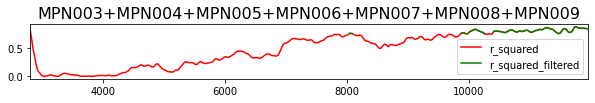

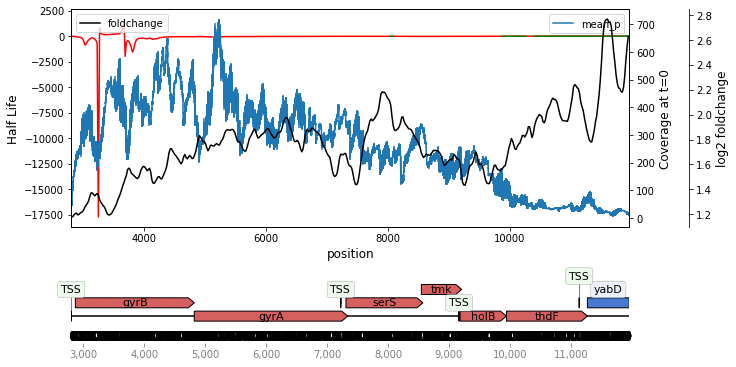

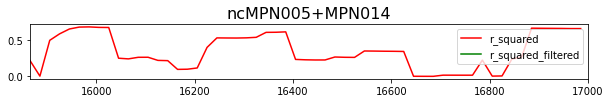

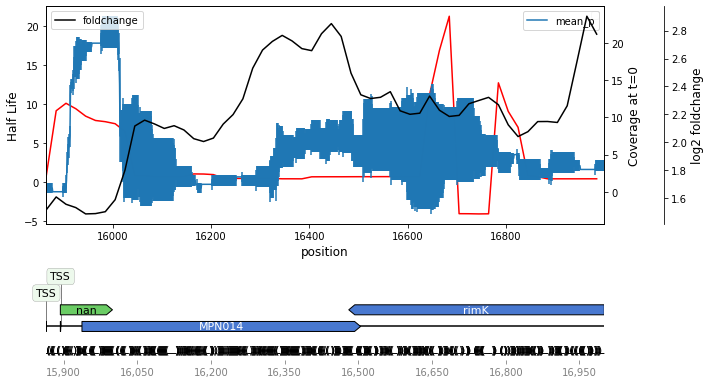

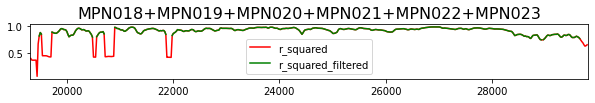

...

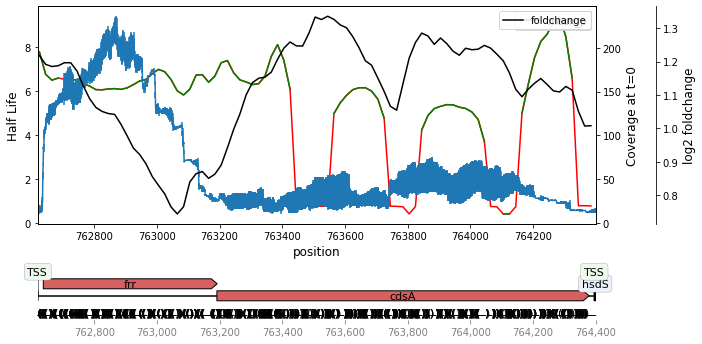

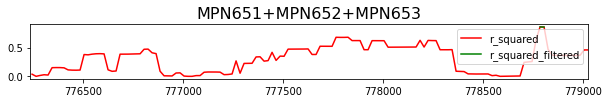

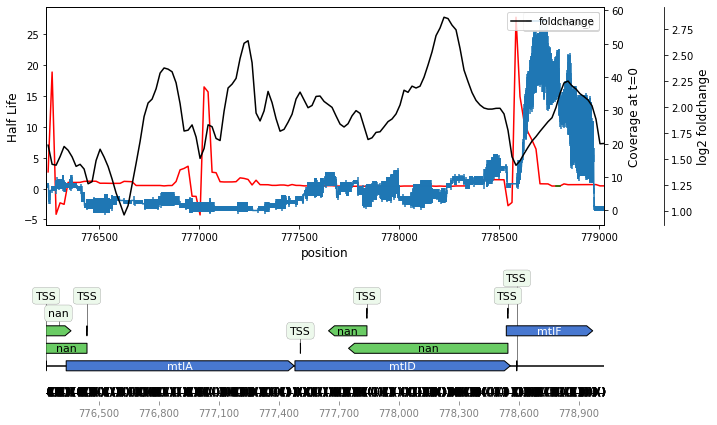

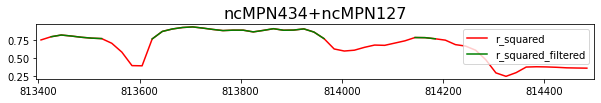

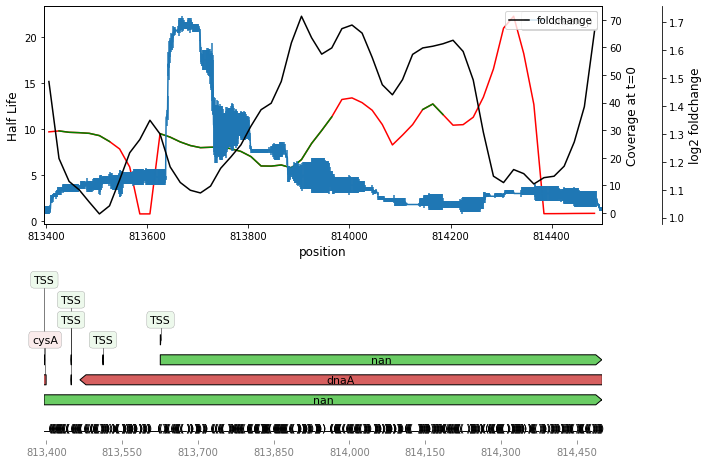

In [2]:
file = open("multiple_CDS_multiple_TSS_operon_coords.bed", "r")
for line in file:
    line=line.strip()
    elements = line.split(",")
    operon = elements[0]
    TSS_operon = elements[1]
    TTS_operon = elements[2]
    if TTS_operon != "--":
        if TSS_operon != "--":
            if elements[3]:
                #if elements[4] == "UP-SENSE":
                plot(int(TSS_operon), int(TTS_operon), operon)
                    #plot_structure(genome_sequence, int(TSS_operon), int(TTS_operon), operon)   #


# MULTIPLE CDS, 1 TSS

In [ ]:
file = open("multiple_CDS_1TSS_operon_coords.bed", "r")
for line in file:
    line=line.strip()
    elements = line.split(",")
    operon = elements[0]
    TSS_operon = elements[1]
    TTS_operon = elements[2]
    if TTS_operon != "--":
        if TSS_operon != "--":
            if elements[3] == "Y":
                plot(int(TSS_operon), int(TTS_operon), operon)
                #plot_structure(genome_sequence, int(TSS_operon), int(TTS_operon), operon)   #


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e6372bad-fbec-49ad-9143-688194f5eed5', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='2e019c0e-7cf0-4614-a96e-81cf62239090', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='8dd8ffcc-3578-44ad-b017-2da0eed7eec5', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='84ecba86-e006-4b30-8af6-063023132cc2', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='f6c90590-d772-40b4-9e7b-22138db60c13', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='8a27c724-c895-46b6-9d5c-3b47f45be322', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='fbff2634-fbfa-4f1c-8a9c-978c6c62c4e2', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='5a775e32-f452-47a1-96d8-cc62b5116eae', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='54009a07-63aa-4beb-a63b-28847123f245', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='aada4aa7-ed52-44fb-8a17-f0d0d557bcf7', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='551bd42d-c54d-45f5-bc26-37e87986f858', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='59b23ce3-4099-47f2-8ce4-b4e85bb5eb08', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7230b5ad-762c-40e9-ae87-2e6be4e2d737', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='ef0a230a-0379-46b9-9fdc-9103027a39b1', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7285e9c8-146b-4e6d-8252-4f3b1d8e8896', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='9b348d9c-4323-40b1-8224-66c0c9cf3e63', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e061ad0c-19f3-409b-8465-38d51603aafd', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='02b20ca4-705d-49dc-a7cb-eec755b115df', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='7ae186ad-15c0-4f91-baf0-c9dfb537f167', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='9a49c555-e3f9-41f5-a54a-f0e5b9922fb9', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:39: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='6be4ff54-ac0b-44d6-8f3e-c92bfe415973', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-ar

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='668b3abc-3962-43e5-8eba-145c2c9b14ae', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='3fe8d6d5-4911-4826-b61c-2510e74d0685', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='df062c07-0f4e-4921-8c4a-dbad540bcbe9', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='239b32a3-1b38-4b02-95cf-ca41ea22fe01', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='6948dd9d-d6fd-4cf9-809f-9d94afb6b447', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='ecd03fa0-effc-4eaf-b2b3-273314ccb8b0', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e51f7579-9b50-4dd8-a7ec-fcd4597e69a5', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b618d081-e29f-4eda-bf09-49638e071f9d', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='09ee70a4-089c-485c-920c-a87bacc06cbd', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b8d13099-3712-4e87-8136-73d3f79d6cec', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='9d0b7584-5e8b-435f-a3ce-b9b14473ce1a', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='1dd7a927-0c4d-49b7-8234-031cd52d2142', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='d030ac94-ba54-42a3-9032-e26d38c18f70', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='4aca3f4f-a6eb-4b2c-9241-f0a294807563', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='50bbcbad-6c3d-4766-ae4e-b3b8447c3191', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='8b25f459-8ec6-4106-9e5d-4de6e5b5beb9', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='b79f5082-b1f4-46e3-b7a7-08af6120d0b8', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='a5b3dc75-aa11-4f41-96ce-b4e6713fd0f5', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='03cec18a-4083-4d3f-bf8d-7bf1ac28979d', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='3999e406-4d33-4d50-b09a-0e6e54da9dea', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='0a7080b5-cecd-429b-ac06-c89ce43ae701', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e68305ab-b62f-44f1-838a-5567100c35c9', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:xlabel='position', ylabel='Half Life'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='e82de393-de73-465b-8f33-624ded9ab189', xlabel='position', ylabel='Coverage at t=0'> instances.
A proxy artist may be used instead.
See: https://matplotlib.org/users/legend_guide.html#creating-artists-specifically-for-adding-to-the-legend-aka-proxy-artists
/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:91: UserWarning: Legend does not support <AxesSubplot:label='64ccf7fc-bceb-410d-b215-86cfffcdc2e6', xlabel='position', ylabel='log2 foldchange'> instances.
A proxy artist may be used instead.
See: https://matplo

v0.2


# Selected genes

v0.2
v0.2
v0.2
v0.2
v0.2
v0.2
v0.2
v0.2
v0.2
v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


v0.2
v0.2
v0.2
v0.2
v0.2
v0.2
v0.2
v0.2
v0.2
v0.2
v0.2
v0.2
v0.2


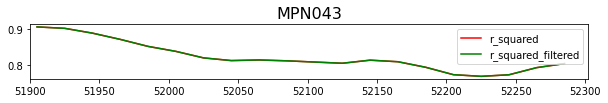

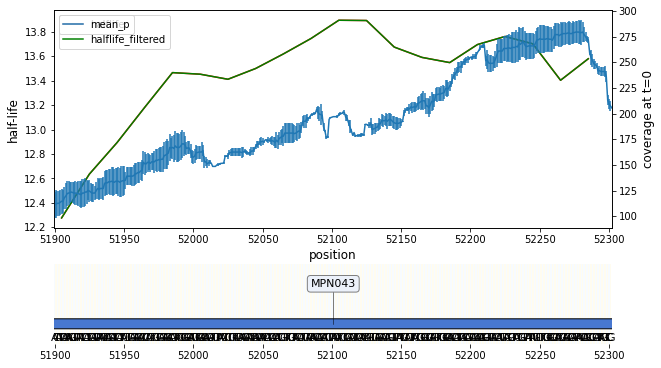

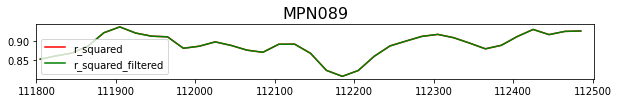

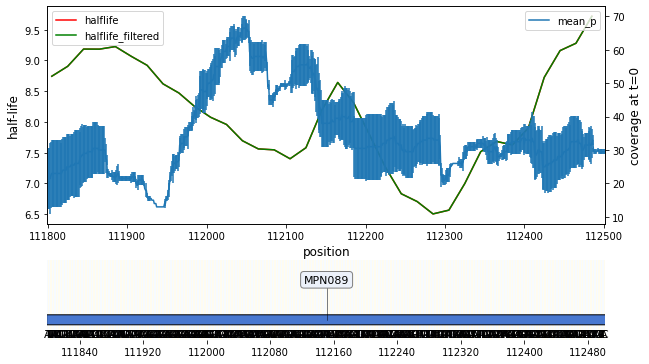

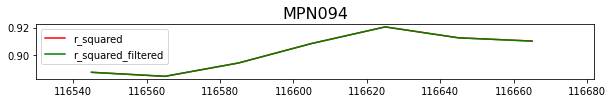

...

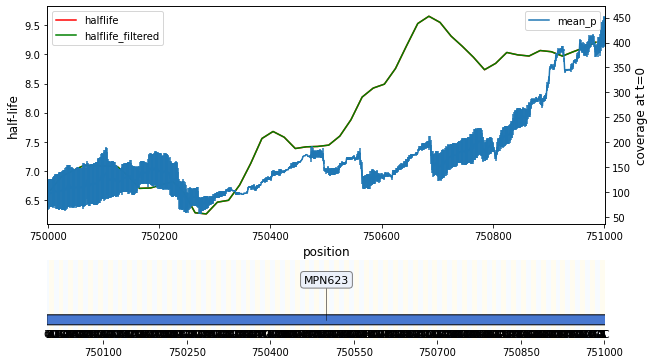

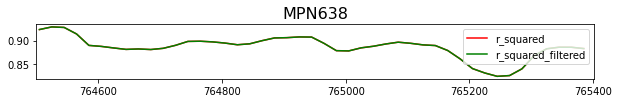

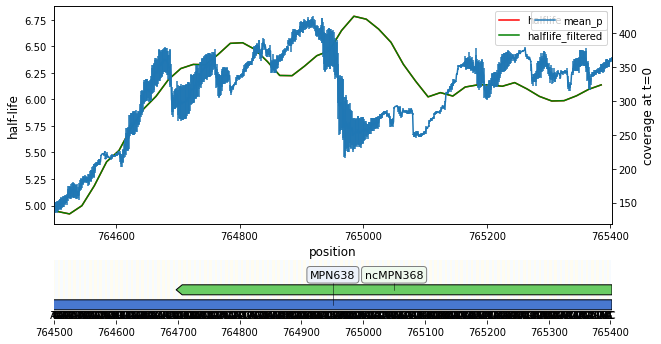

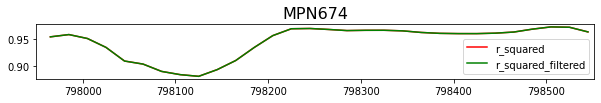

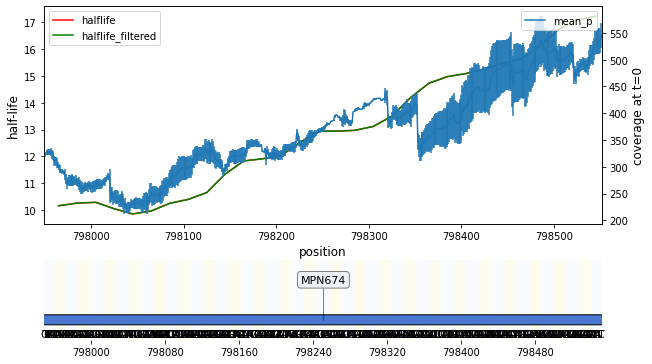

In [7]:
coords_file = open("selected_genes.txt")
for line in coords_file:
    line = line.strip()
    elements = line.split("\t")
    plot(int(elements[1]), int(elements[2]), elements[0])

# SELECTED GENES 2

v0.2
v0.2
v0.2
v0.2
v0.2
v0.2
v0.2
v0.2
v0.2
v0.2


/home/oscar/.local/lib/python3.6/site-packages/ipykernel_launcher.py:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


v0.2
v0.2
v0.2
v0.2
v0.2
v0.2
v0.2


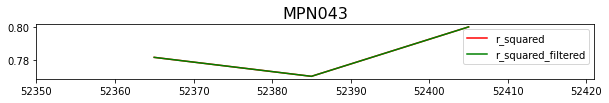

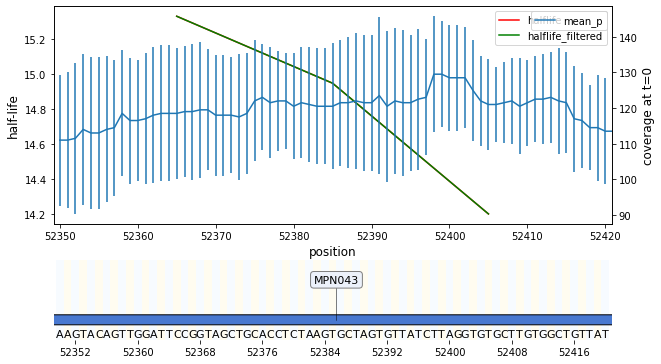

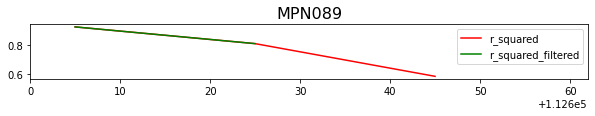

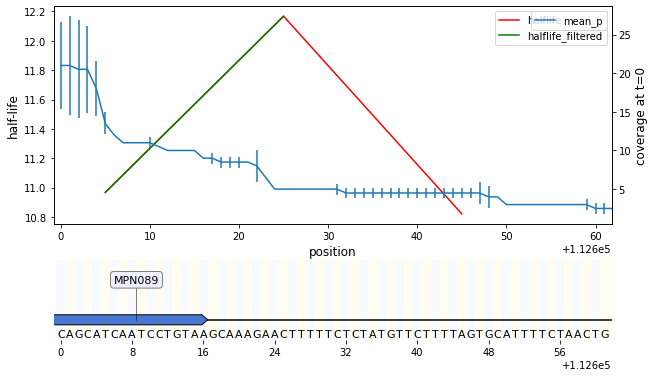

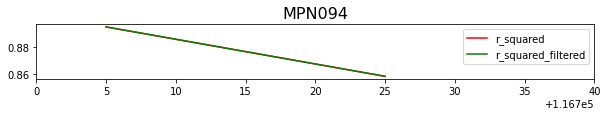

...

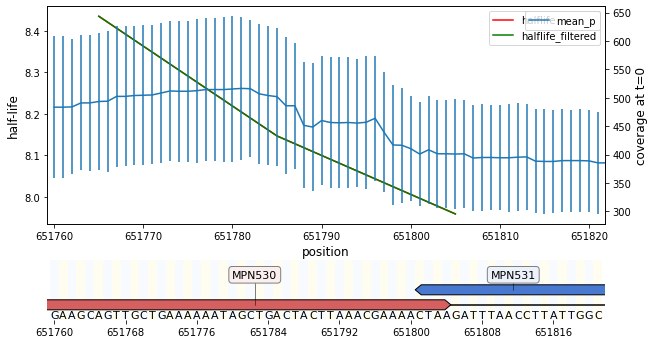

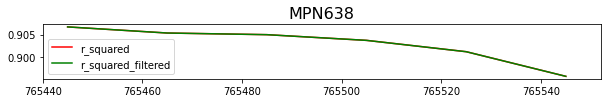

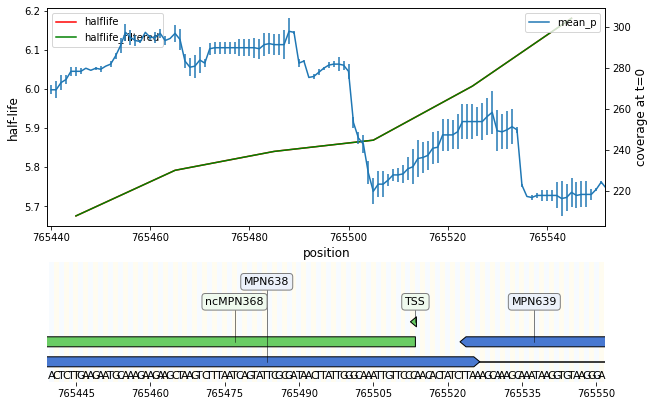

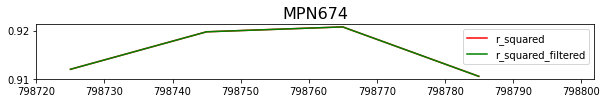

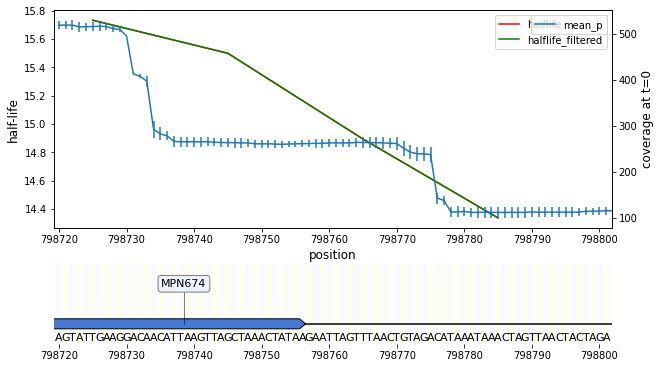

In [6]:
coords_file = open("selected_genes2.txt")
for line in coords_file:
    line = line.strip()
    elements = line.split("\t")
    plot(int(elements[1]), int(elements[2]), elements[0])